## Sound Classification: Frog or no Frog

In [1]:
import os
import random
import io

import matplotlib.pyplot as plt
import scipy
import scipy.misc
from scipy.io import wavfile

from pydub import AudioSegment, silence
from pydub.playback import play

import numpy as np

In [2]:
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import utils
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.optimizers import SGD, RMSprop, Adam
from tensorflow.keras.callbacks import EarlyStopping

In [3]:
def ensure_folder_exists(absolute_path):
        if not os.path.exists(absolute_path):
            os.makedirs(absolute_path)

In [4]:
ensure_folder_exists('./data')

In [5]:
ensure_folder_exists('./rawdata/train/frog')
ensure_folder_exists('./rawdata/train/nofrog')
ensure_folder_exists('./rawdata/test/frog')
ensure_folder_exists('./rawdata/test/nofrog')

In [6]:
ensure_folder_exists('./models')

# Converting sound files to spectograms

#### Step 1: Get model training data

In [7]:
frog_train_audio_dr = './rawdata/train/frog/'
notfrog_train_audio_dr = './rawdata/train/nofrog/'
frog_test_audio_dr = './rawdata/test/frog/'
notfrog_test_audio_dr = './rawdata/test/nofrog/'

In [8]:
frog_audio_files = os. listdir(frog_train_audio_dr)
print(len(frog_audio_files))
print(frog_audio_files)

9
['.amlignore', '.amlignore.amltmp', 'Tp1_077S01_20200310_190000_j.wav', 'Tp1_077S01_20200310_190000_k.wav', 'Tp1_077S01_20200310_190000_l.wav', 'Tp1_077S01_20200310_190000_m.wav', 'Tp1_077S01_20200310_190000_n.wav', 'Tp1_077S01_20200310_190000_o.wav', 'Tp1_077S02_20150223_173000_c.wav']


In [9]:
nofrog_audio_files = os. listdir(notfrog_train_audio_dr)
print(len(nofrog_audio_files))
print(nofrog_audio_files)

10
['.amlignore', '.amlignore.amltmp', 'Tp0_014S02_20120926_220000.mp3', 'Tp0_014S02_20180120_193000.mp3', 'Tp0_014S02_20180920_193000.mp3', 'Tp0_014S02_20180930_193000.mp3', 'Tp0_014S02_20181105_170000.mp3', 'Tp0_114S01_20121216_220000.mp3', 'Tp0_114S02_20121213_030000.mp3', 'Tp1_077S01_20181022_173000.mp3']


In [10]:
frog_audio= AudioSegment.from_file(file = frog_train_audio_dr+frog_audio_files[3],format = "mp3") 

In [11]:
frog_audio

In [12]:
nofrog_audio= AudioSegment.from_file(file = notfrog_train_audio_dr+nofrog_audio_files[3],format = "mp3") 

In [13]:
nofrog_audio

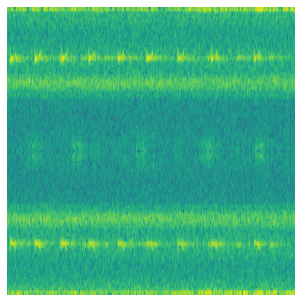

In [14]:
plt.rcParams['figure.figsize'] = [4,4]

fig,ax = plt.subplots(1)
fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
ax.axis('off')
pxx, freqs, bins, im = ax.specgram(frog_audio.get_array_of_samples(),Fs=frog_audio.frame_rate)
ax.axis('off')
plt.rcParams['figure.figsize'] = [4,4]
fig.savefig('frog.png', dpi=300)
fig.show()

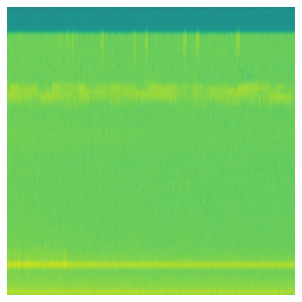

In [15]:
fig,ax = plt.subplots(1)
fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
ax.axis('off')
pxx, freqs, bins, im = ax.specgram(nofrog_audio.get_array_of_samples(),Fs=nofrog_audio.frame_rate)
ax.axis('off')
#plt.rcParams['figure.figsize'] = [1,1]
fig.savefig('nofrog.png', dpi=300)
fig.show()

#### Splitting sound files into 200 ms chunks
##### Frog

In [18]:
w = 200 ## 200 ms chunks

chunks = []
for audio_file in frog_audio_files:
    file_type = str.split(audio_file,'.')[-1]
    if (file_type in ['wav']):
        sound_file = AudioSegment.from_file(file = frog_train_audio_dr+audio_file,format = "wav")  ## reading mp3 files
        chunks.append([sound_file[i:i+w] for i in range(0, len(sound_file), w)])

In [82]:
frog_train_data = [x for y in chunks for x in y]
frog_train_data[0]

In [85]:
len(frog_train_data)

2408

##### No frog

In [21]:
w = 200 ## 200 ms chunks

chunks = []
for audio_file in nofrog_audio_files:
    file_type = str.split(audio_file,'.')[-1]
    if (file_type in ['mp3']):
        sound_file = AudioSegment.from_file(file = notfrog_train_audio_dr+audio_file,format = "mp3")  ## reading mp3 files
        chunks.append([sound_file[i:i+w] for i in range(0, len(sound_file), w)])

In [83]:
nofrog_train_data = [x for y in chunks for x in y]
nofrog_train_data[100]

In [84]:
len(nofrog_train_data)

2408

**Frog test data**

In [24]:
w = 200 ## 200 ms chunks
frog_test_audio_files = os. listdir(frog_test_audio_dr)
print(frog_test_audio_files)
chunks = []
for audio_file in frog_test_audio_files:
    file_type = str.split(audio_file,'.')[-1]
    if (file_type in ['mp3']):
        sound_file = AudioSegment.from_file(file = frog_test_audio_dr+audio_file,format = "mp3")  ## mp3 file
        chunks.append([sound_file[i:i+w] for i in range(0, len(sound_file), w)])

frog_test_audio_data = [x for y in chunks for x in y]

len(frog_test_audio_data)

['.amlignore', '.amlignore.amltmp', 'desktop.ini', 'Tp1_077S01_20131104_193000.mp3', 'Tp1_077S01_20131110_030000.mp3', 'Tp1_077S01_20131110_033000.mp3', 'Tp1_077S01_20131110_040000.mp3', 'Tp1_077S01_20131111_013000.mp3', 'Tp1_077S01_20131111_020000.mp3']


1806

**No Frog test data**

In [25]:
w = 200 ## 200 ms chunks
nofrog_test_audio_files = os. listdir(notfrog_test_audio_dr)
print(nofrog_test_audio_files)
chunks = []
for audio_file in nofrog_test_audio_files:
    file_type = str.split(audio_file,'.')[-1]
    if (file_type in ['mp3']):
        sound_file = AudioSegment.from_file(file = notfrog_test_audio_dr+audio_file,format = "mp3")  ## mp3 file
        chunks.append([sound_file[i:i+w] for i in range(0, len(sound_file), w)])

nofrog_test_audio_data = [x for y in chunks for x in y]

len(nofrog_test_audio_data)

['.amlignore', '.amlignore.amltmp', 'Tp0_014S01_20180905_193000.mp3', 'Tp0_014S01_20180915_040000.mp3', 'Tp0_014S01_20180915_193000.mp3', 'Tp0_014S02_20120926_220000.mp3', 'Tp0_014S02_20180120_193000.mp3', 'Tp0_014S02_20180920_193000.mp3', 'Tp0_014S02_20180930_193000.mp3', 'Tp0_014S02_20181105_170000.mp3']


2408

### Converting sound (wav/mp3) to image(spectogram) 

**Train data**

In [26]:
train_frog_dr = './data/train/frog/'
train_nofrog_dr = './data/train/nofrog/'

In [27]:
ensure_folder_exists(train_frog_dr)
ensure_folder_exists(train_nofrog_dr)

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=256).
  """
/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=192).
  """


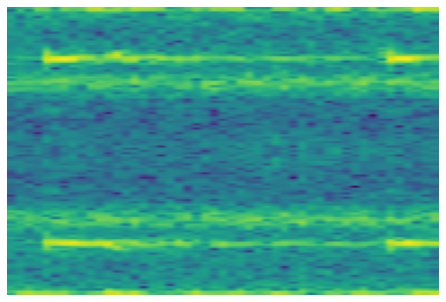

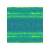

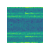

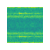

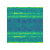

...

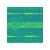

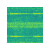

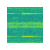

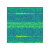

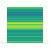

In [28]:
for i, chunk in enumerate(frog_train_data):
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('off')
    pxx, freqs, bins, im = ax.specgram(chunk.get_array_of_samples(),Fs=chunk.frame_rate)
    ax.axis('off')
    plt.rcParams['figure.figsize'] = [0.5,0.5]
    fig.savefig(train_frog_dr+'frog_{}.png'.format(i), dpi=300)
    fig.show()

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=128).
  """


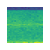

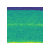

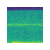

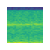

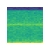

...

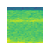

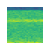

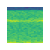

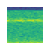

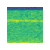

In [29]:
for i, chunk in enumerate(nofrog_train_data):
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('off')
    pxx, freqs, bins, im = ax.specgram(chunk.get_array_of_samples(),Fs=chunk.frame_rate)
    ax.axis('off')
    plt.rcParams['figure.figsize'] = [0.5,0.5]
    fig.savefig(train_nofrog_dr+'nofrog_{}.png'.format(i), dpi=300)
    fig.show()

**Test data**

In [30]:
test_frog_dr = './data/test/frog/'
test_nofrog_dr = './data/test/nofrog/'

In [31]:
ensure_folder_exists(test_frog_dr)
ensure_folder_exists(test_nofrog_dr)

In [32]:
for i, chunk in enumerate(frog_test_audio_data):
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('off')
    pxx, freqs, bins, im = ax.specgram(chunk.get_array_of_samples(),Fs=chunk.frame_rate)
    ax.axis('off')
    plt.rcParams['figure.figsize'] = [0.5,0.5]
    fig.savefig(test_frog_dr+'frog_{}.png'.format(i), dpi=300)
    fig.show()

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=128).
  """


/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=128).
  """


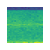

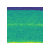

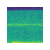

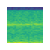

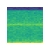

...

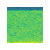

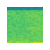

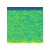

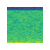

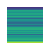

In [33]:
for i, chunk in enumerate(nofrog_test_audio_data):
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('off')
    pxx, freqs, bins, im = ax.specgram(chunk.get_array_of_samples(),Fs=chunk.frame_rate)
    ax.axis('off')
    plt.rcParams['figure.figsize'] = [0.5,0.5]
    fig.savefig(test_nofrog_dr+'nofrog_{}.png'.format(i), dpi=300)
    fig.show()

In [34]:
print(len(os.listdir(train_frog_dr)))
print(len(os.listdir(train_nofrog_dr)))
print(len(os.listdir(test_frog_dr)))
print(len(os.listdir(test_nofrog_dr)))

2408
2408
1806
2409


### Preprocessing and converting image data to numpy arrays for classification task

**Training**

**Frog**


In [35]:
all_frog_images = []
for image_path in os.listdir(train_frog_dr):
    file_type = str.split(image_path,'.')[-1]
    if (file_type in ['png', 'jpeg']):
        image = load_img(train_frog_dr+image_path , target_size = [100,100])
        input_arr = img_to_array(image)
        all_frog_images.append(input_arr)
print(input_arr.shape)
print(len(all_frog_images))

(100, 100, 3)
2408


In [36]:
X_train = np.array(all_frog_images)
y_train = np.ones(len(all_frog_images))
print(X_train.shape)
print(y_train.shape)

(2408, 100, 100, 3)
(2408,)


***Not frog***

In [37]:
all_nonfrog_images = []
for image_path in os.listdir(train_nofrog_dr):
    file_type = str.split(image_path,'.')[-1]
    if (file_type in ['png', 'jpeg']):
        image = load_img(train_nofrog_dr+image_path , target_size = [100,100])
        input_arr = img_to_array(image)
        all_nonfrog_images.append(input_arr)
print(input_arr.shape)
print(len(all_nonfrog_images))

(100, 100, 3)
2408


***Putting all the training data together***

In [38]:
X_train = np.concatenate((X_train, np.array(all_nonfrog_images)), axis = 0)
y_train = np.concatenate((y_train, np.zeros(len(all_nonfrog_images))), axis = 0)
print(X_train.shape)
print(y_train.shape)

(4816, 100, 100, 3)
(4816,)


***Shuffle data***

In [39]:
reorder = np.random.permutation(len(X_train))
X_train = X_train[reorder]
y_train = y_train[reorder]

**Testing**

***Frog***

In [40]:
all_frog_val_images = []
for image_path in os.listdir(test_frog_dr):
    file_type = str.split(image_path,'.')[-1]
    if (file_type in ['png', 'jpeg']):
        image = load_img(test_frog_dr+image_path , target_size = [100,100])
        input_arr = img_to_array(image)
        all_frog_val_images.append(input_arr)
print(input_arr.shape)
print(len(all_frog_val_images))

(100, 100, 3)
1806


In [41]:
X_test = np.array(all_frog_val_images)
y_test = np.ones(len(all_frog_val_images))
print(X_test.shape)
print(y_test.shape)

(1806, 100, 100, 3)
(1806,)


**No Frog**

In [42]:
all_nonfrog_val_images = []
for image_path in os.listdir(test_nofrog_dr):
    file_type = str.split(image_path,'.')[-1]
    if (file_type in ['png', 'jpeg']):
        image = load_img(test_nofrog_dr+image_path , target_size = [100,100])
        input_arr = img_to_array(image)
        all_nonfrog_val_images.append(input_arr)
print(input_arr.shape)
print(len(all_nonfrog_val_images))

(100, 100, 3)
2408


***Putting all the validation/test data together***

In [43]:
X_test = np.concatenate((X_test, np.array(all_nonfrog_val_images)), axis = 0)
y_test = np.concatenate((y_test, np.zeros(len(all_nonfrog_val_images))), axis = 0)
print(X_test.shape)
print(y_test.shape)

(4214, 100, 100, 3)
(4214,)


***Shuffle data***

In [44]:
reorder = np.random.permutation(len(X_test))
X_test = X_test[reorder]
y_test = y_test[reorder]

***Normalize data***

In [45]:
# normalize inputs from 0-255 to 0.0-1.0
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
X_train = X_train / 255.0
X_test = X_test / 255.0

# CNN for image (sound) classification

In [55]:
model = Sequential()
model.add(Conv2D(32, (3, 3), input_shape=(100,100, 3), padding='same', activation='relu'))
model.add(Dropout(0.2))
model.add(Conv2D(16, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D())
model.add(Flatten())
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))

In [56]:
#model parameters
epochs = 50
lrate = 0.0001
batch_size  = 50

In [57]:
model.compile(loss='binary_crossentropy', optimizer=Adam(lr=lrate),metrics=['accuracy'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 100, 100, 32)      896       
_________________________________________________________________
dropout_2 (Dropout)          (None, 100, 100, 32)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 100, 100, 16)      4624      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 50, 50, 16)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 40000)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 512)               20480512  
_________________________________________________________________
dropout_3 (Dropout)          (None, 512)              

In [58]:
earlystop_callback = EarlyStopping(
    monitor='val_loss', min_delta=0, patience=0, verbose=0,
    mode='auto', baseline=None, restore_best_weights=False
)

In [59]:
# Fit the model
#history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, callbacks= [earlystop_callback], validation_data = (X_test, y_test)) 
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_data = (X_test, y_test)) #without early stopping just to visualize the training runs

Train on 4816 samples, validate on 4214 samples
Epoch 1/50
4816/4816 [==============================] - 56s 12ms/sample - loss: 0.7266 - accuracy: 0.5687 - val_loss: 0.6303 - val_accuracy: 0.68
Epoch 2/50
4816/4816 [==============================] - 54s 11ms/sample - loss: 0.6113 - accuracy: 0.6310 - val_loss: 0.5959 - val_accuracy: 0.68
Epoch 3/50
4816/4816 [==============================] - 65s 14ms/sample - loss: 0.5715 - accuracy: 0.6491 - val_loss: 0.5632 - val_accuracy: 0.64
Epoch 4/50
4816/4816 [==============================] - 67s 14ms/sample - loss: 0.5445 - accuracy: 0.6640 - val_loss: 0.4895 - val_accuracy: 0.67
Epoch 5/50
4816/4816 [==============================] - 67s 14ms/sample - loss: 0.5217 - accuracy: 0.6603 - val_loss: 0.4572 - val_accuracy: 0.68
Epoch 6/50
4816/4816 [==============================] - 66s 14ms/sample - loss: 0.5050 - accuracy: 0.6740 - val_loss: 0.4387 - val_accuracy: 0.71
Epoch 7/50
4816/4816 [==============================] - 67s 14ms/sample - lo

In [60]:
plt.rcParams['figure.figsize'] = [10,10]

loss_values = history.history['loss']
epochs = range(1, len(loss_values)+1)

plt.plot(epochs, loss_values, label='Training Loss')
plt.plot(epochs, history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

# Save model

In [62]:
# loading model
from tensorflow.keras.models import model_from_json

In [63]:
def save_model(model):
    # saving model
    json_model = model.to_json()
    open('model_architecture.json', 'w').write(json_model)
    # saving weights
    model.save_weights('model_weights.h5', overwrite=True)

In [64]:
def load_model():
    # loading model
    model = model_from_json(open('model_architecture.json').read())
    model.load_weights('model_weights.h5')
    model.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.001),metrics='accuracy')
    return model

In [ ]:
#model.save('./models/sound.h5')

In [ ]:
# save
save_model(model)

In [ ]:
# load
loaded_model = load_model()

***Load/check model***

In [ ]:
#loaded_model = tf.keras.models.load_model('./models/sound.h5')
loaded_model.summary()

In [ ]:
# predictions
predictions = model.predict_classes(X_test, verbose=0)

In [ ]:
print(predictions)

## Methods to pre-process the inference (live stream) data

In [ ]:
def process_audio(audioSeg):
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('tight')
    ax.axis('off')
    pxx, freqs, bins, im = ax.specgram(audioSeg.get_array_of_samples(),Fs=audioSeg.frame_rate)
    ax.axis('off')
    plt.rcParams['figure.figsize'] = [0.5,0.5]
    fig.savefig('audio_spec.png'.format(i), dpi=300)
   # fig.show()
    return 'audio_spec.png'

In [ ]:
def convert_image(image_file):
    image = load_img(image_file, target_size = [100,100])
    input_arr = img_to_array(image)
    test_sample  = np.array(input_arr)
    test_sample = test_sample.astype('float32')
    test_sample = test_sample / 255.0
    test_sample = np.expand_dims(test_sample, axis = 0)
    return test_sample

**Testing the trained model**

In [ ]:
w = 200 ## 200 ms chunks

chunks = []
audio_file = misty_test_audio
file_type = str.split(audio_file,'.')[-1]

if (file_type in ['mp3']):
        wav_file = AudioSegment.from_file(file = misty_audio_dr+audio_file, format = 'wav')
        chunks.append([wav_file[i:i+w] for i in range(0, len(wav_file), w)])

audio_file = user_test_audio
file_type = str.split(audio_file,'.')[-1]

if (file_type in ['wav']):
        wav_file = AudioSegment.from_mp3(file = user_audio_dr+audio_file)
        chunks.append([wav_file[i:i+w] for i in range(0, len(wav_file), w)])
chunks = chunks[0]        

In [ ]:
x = random.randint(0,len(chunks)-1)
audioSeg = chunks[x]
dBFS=audioSeg.dBFS
silent_parts =  silence.detect_silence(audioSeg, min_silence_len=1, silence_thresh=dBFS-16)
while(silent_parts and silent_parts[0] == [0,200]):
    x = random.randint(0,len(chunks)-1)
    audioSeg = chunks[x]
    dBFS=audioSeg.dBFS
    silent_parts =  silence.detect_silence(audioSeg, min_silence_len=1, silence_thresh=dBFS-16)

In [ ]:
audio_image  = process_audio(audioSeg)

In [ ]:
test_sample = convert_image(audio_image)

In [ ]:
misty_speaking  = loaded_model.predict(test_sample)

In [ ]:
misty_speaking

In [ ]:
audioSeg

***Leaving a random sample of data for testing the model later***

In [ ]:
frog_test_audio = frog_audio_files[random.randint(0,len(frog_audio_files))]
nofrog_test_audio = nofrog_audio_files[random.randint(0,len(nofrog_audio_files))]
print(frog_test_audio)
print(nofrog_test_audio)

In [ ]:
frog_audio_files.remove(frog_test_audio)
print(len(frog_audio_files))
nofrog_audio_files.remove(nofrog_test_audio)
print(len(nofrog_audio_files))

#### Splitting data for training and testing train and test data

In [ ]:
train_size = 0.8

In [ ]:
train_frog = int(train_size*len(frog_audio_files))
train_nofrog = int(0.8*len(nofrog_audio_files))
print(train_frog)
print(train_nofrog)

In [ ]:
random.shuffle(frog_audio_files)
random.shuffle(nofrog_audio_files)

In [ ]:
train_frog_files = frog_audio_files[:train_frog]
test_frog_files = frog_audio_files[train_frog:]

train_nofrog_files = nofrog_audio_files[:train_nofrog]
test_nofrog_files = nofrog_audio_files[train_nofrog:]